Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [1]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/'
sys.path.append(root)

from ampis import data_utils, visualize

%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [2]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path(ocean_images,'satellite_auto_training_v1.6.json')  # path to training data
json_path_val = Path(ocean_images, 'satellite_auto_validation_v2.2.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [3]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

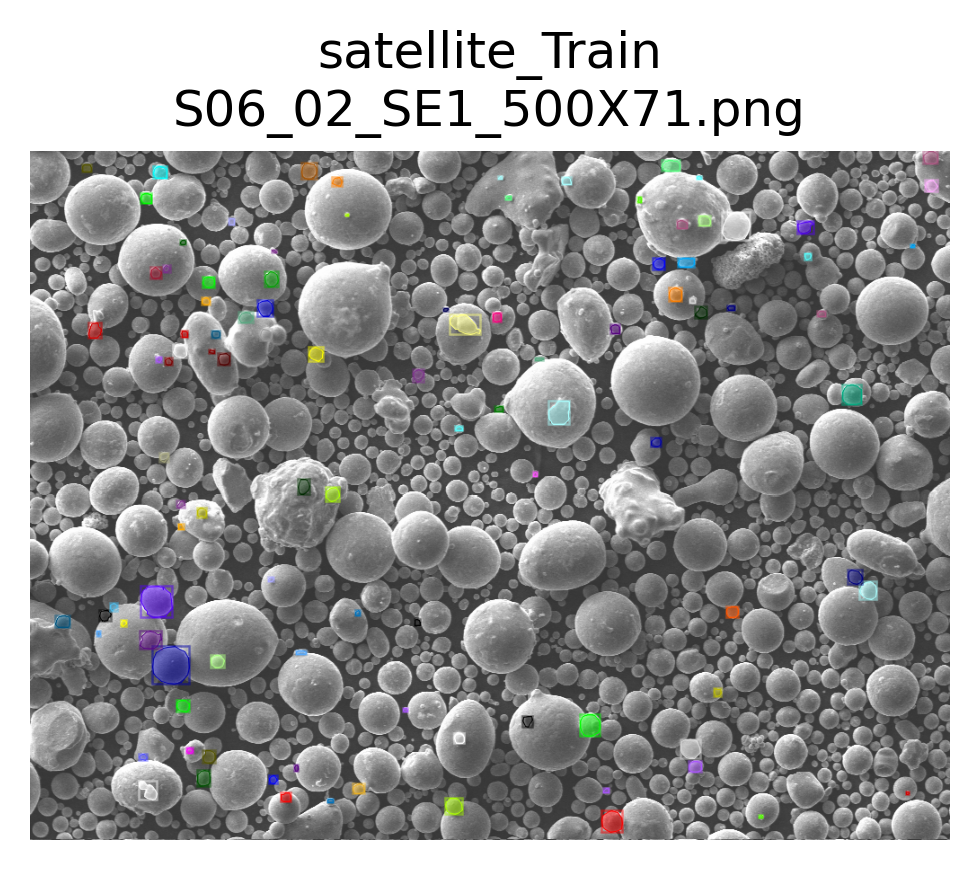

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 104


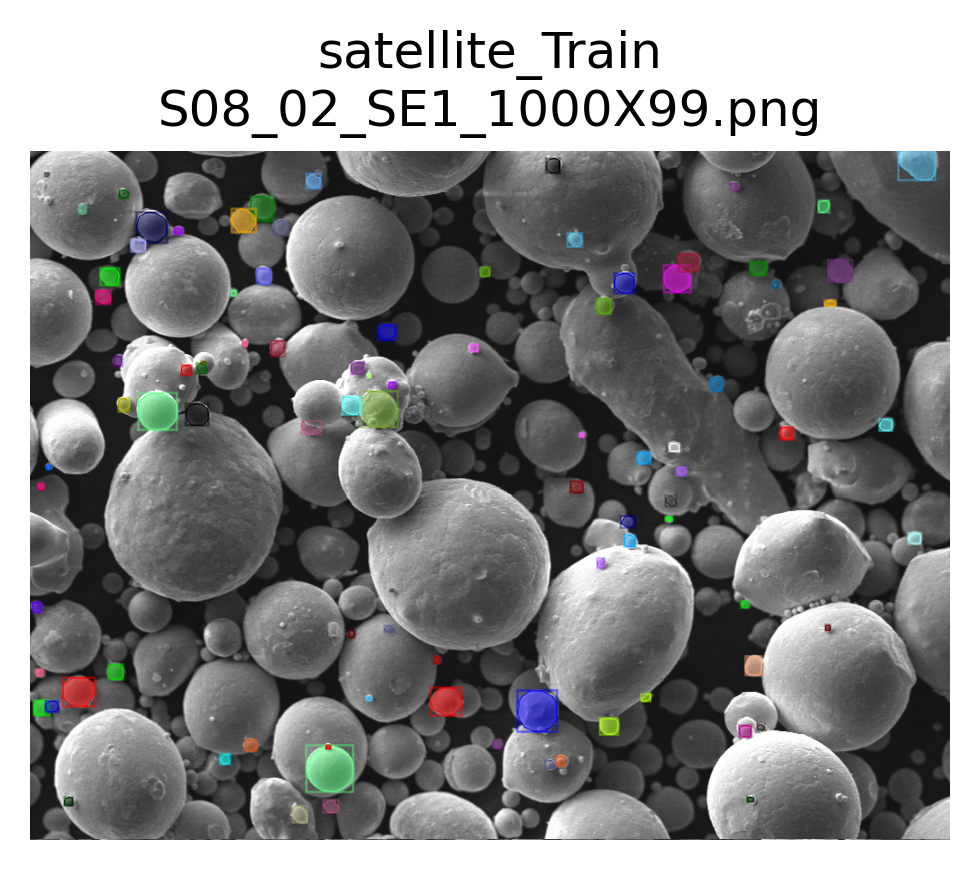

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 93


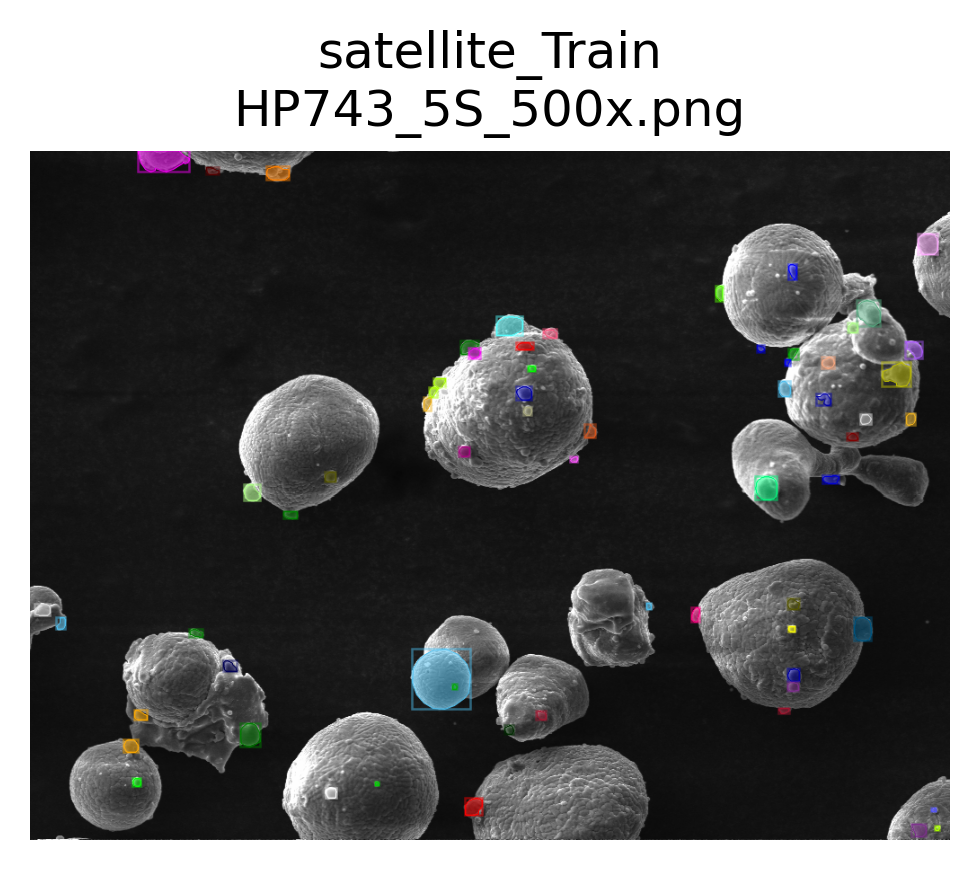

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 65


In [4]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

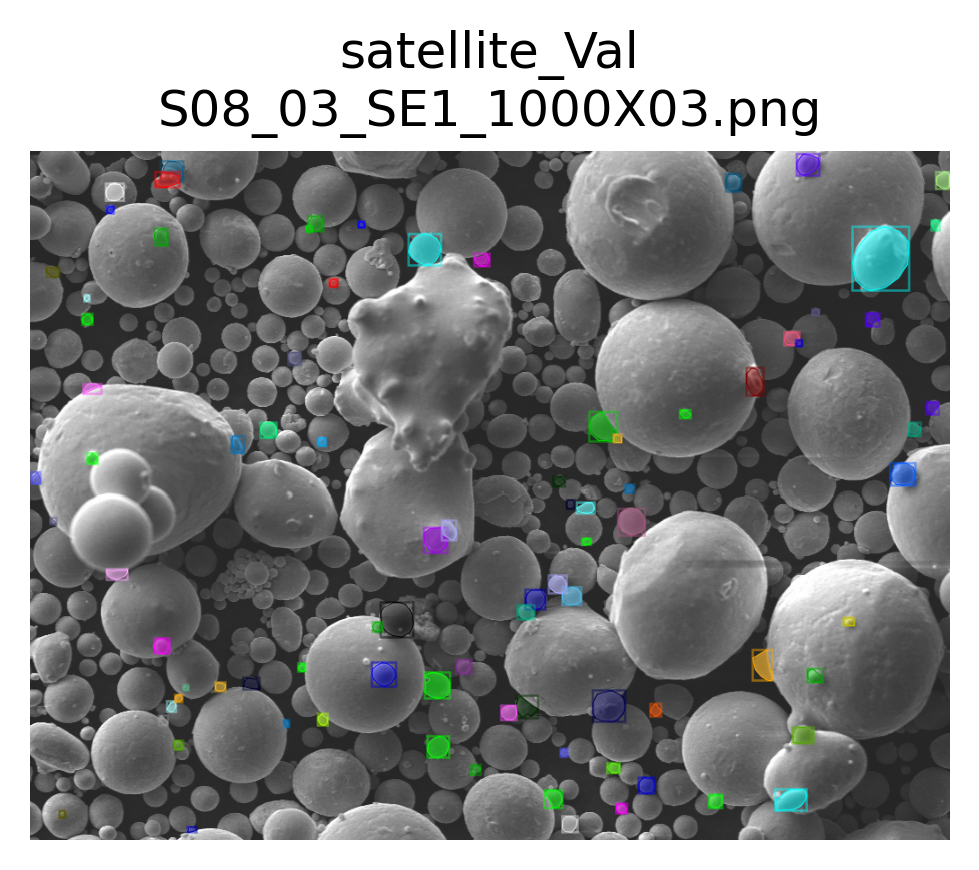

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


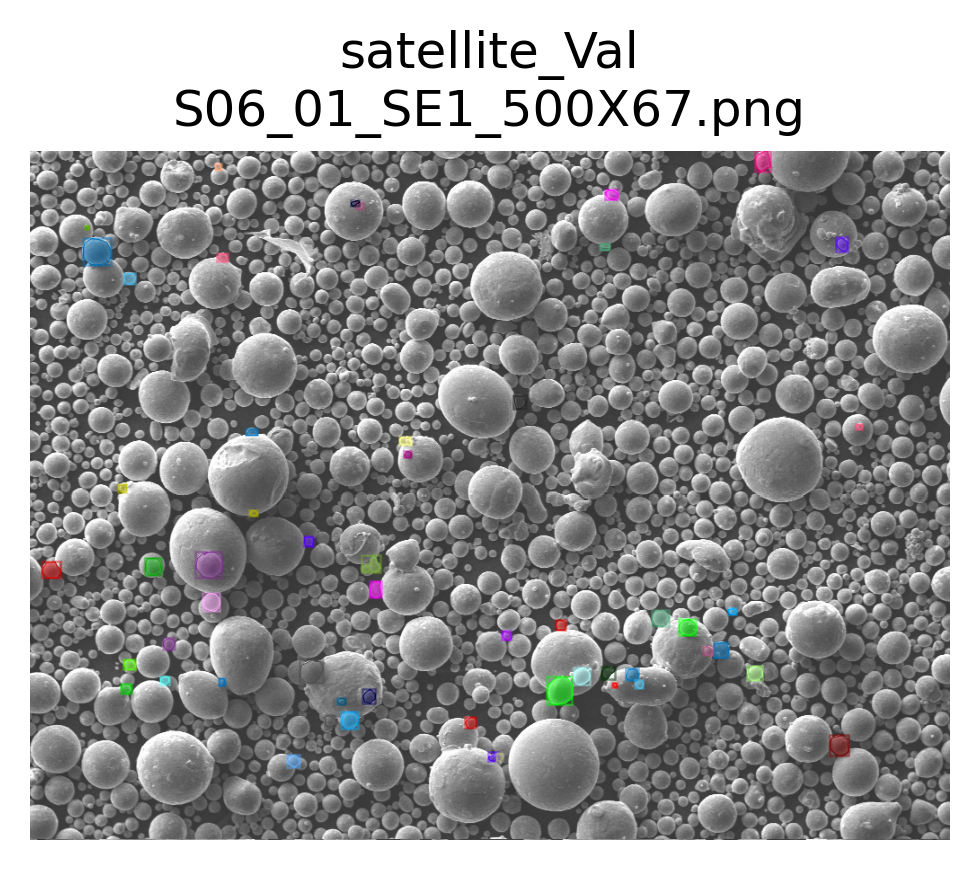

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


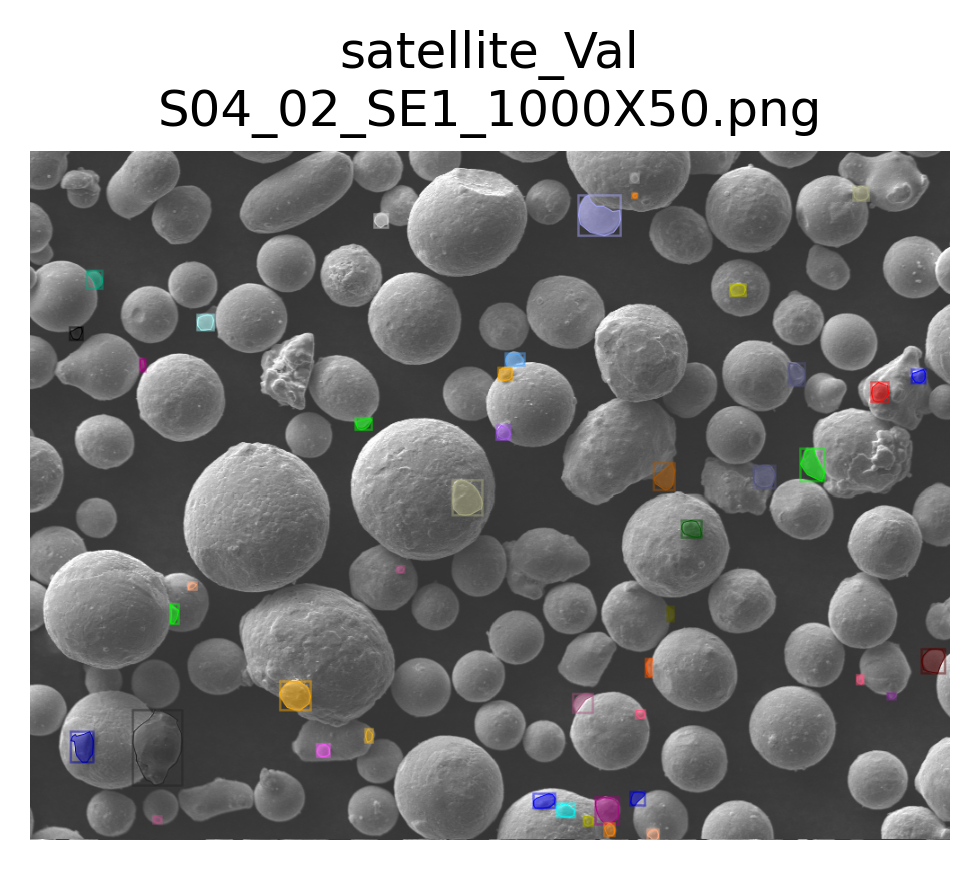

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


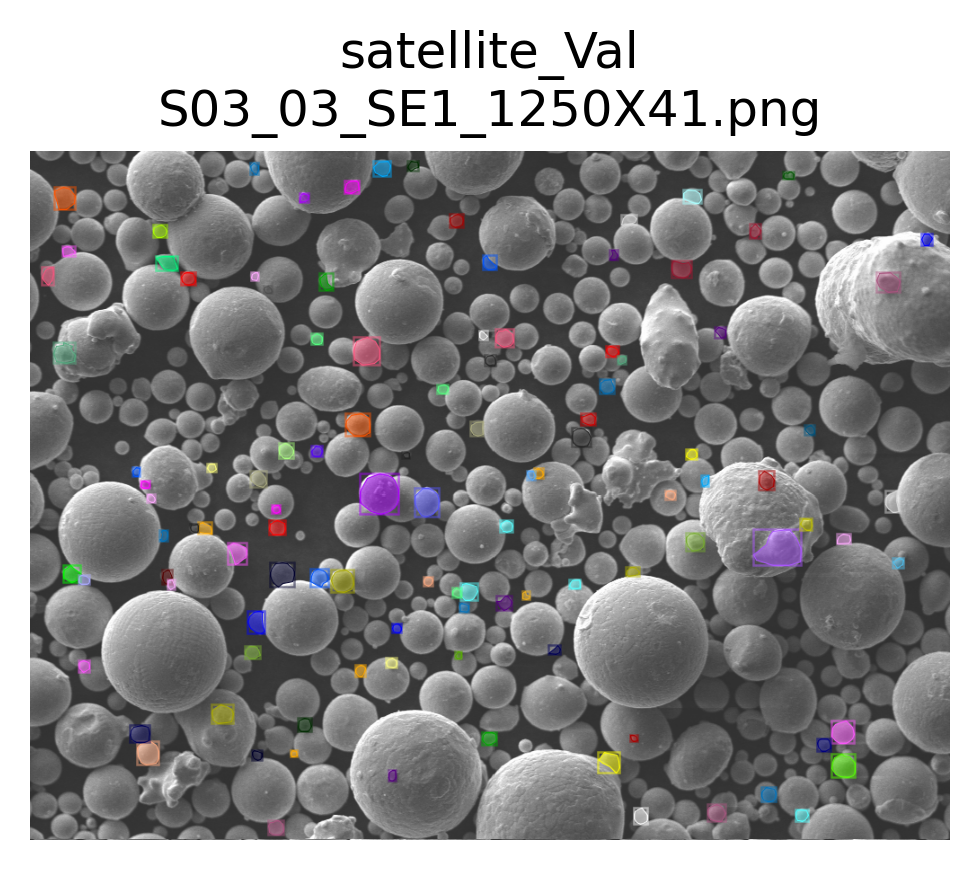

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


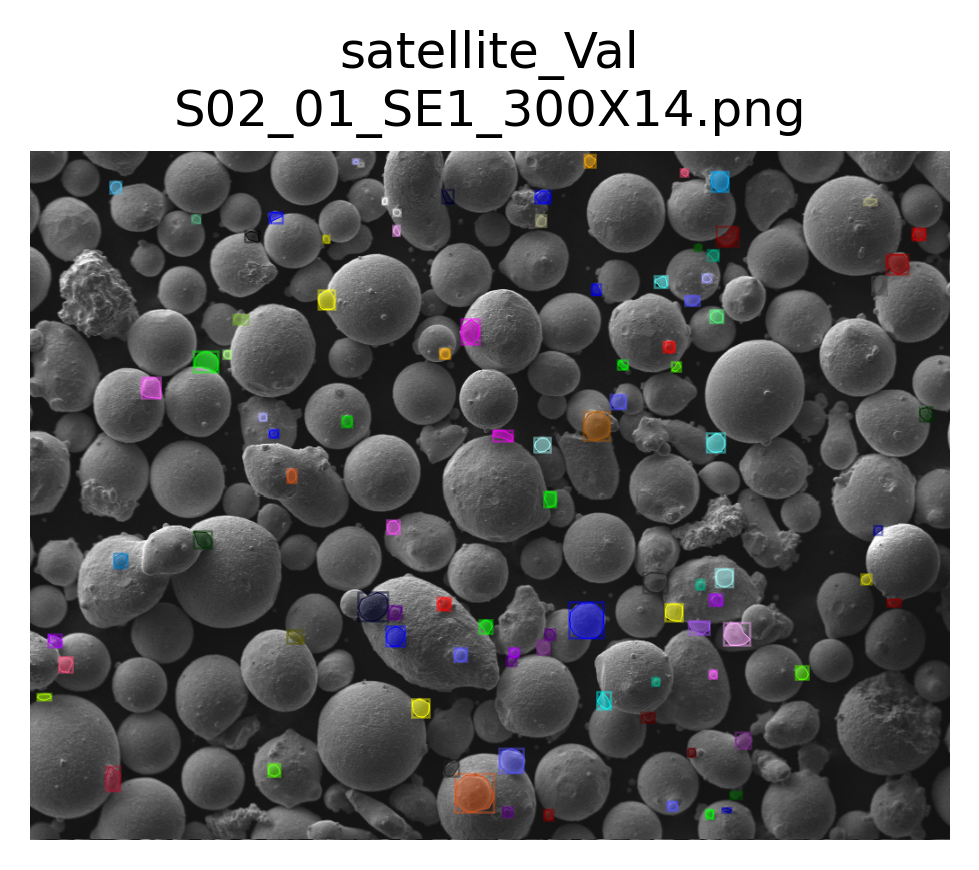

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


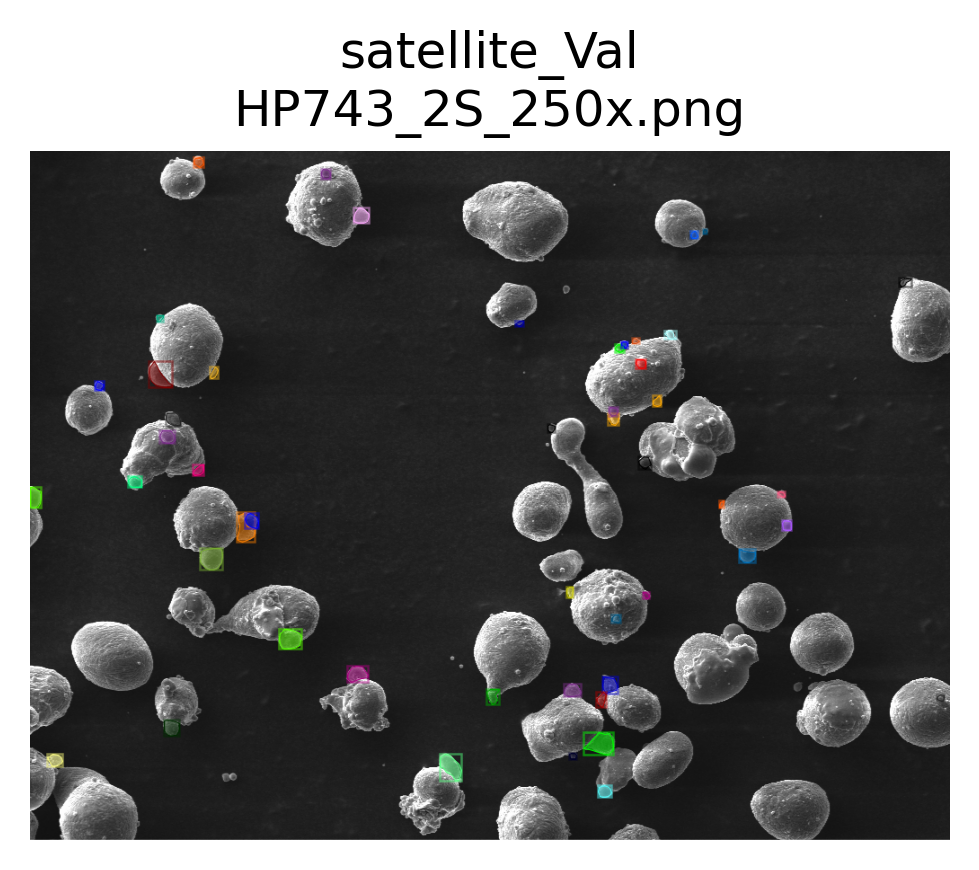

ddict info:
	path: ../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [5]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [5]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 5000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 60000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)

# model weights will be downloaded if they are not present
weights_path = Path('..','..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path(ocean_images,'Models', 'Transformation_Comp_60000', 'Stage_1.6'))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [ ]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[07/13 03:36:48 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[07/13 03:36:50 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[07/13 03:36:50 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| satellite  | 1412         |
|            |              |
[07/13 03:36:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[07/13 03:36:50 d2.data.build]: Using training sampler TrainingSampler
[07/13 03:36:50 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[07/13 03:36:50 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [07/13 03:36:50 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.


/jet/home/sprice/.local/lib/python3.8/site-packages/torch/utils/data/dataloader.py:474: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 1, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[07/13 03:36:50 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[07/13 03:36:50 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:-------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w} | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*  

[07/13 03:37:23 d2.utils.events]:  eta: 2:17:49  iter: 219  total_loss: 1.775  loss_cls: 0.2776  loss_box_reg: 0.4233  loss_mask: 0.3705  loss_rpn_cls: 0.2803  loss_rpn_loc: 0.4867  time: 0.1420  data_time: 0.0130  lr: 0.0043956  max_mem: 1822M
[07/13 03:37:26 d2.utils.events]:  eta: 2:17:54  iter: 239  total_loss: 1.671  loss_cls: 0.2073  loss_box_reg: 0.366  loss_mask: 0.3327  loss_rpn_cls: 0.2497  loss_rpn_loc: 0.4472  time: 0.1418  data_time: 0.0150  lr: 0.0047952  max_mem: 1822M
[07/13 03:37:29 d2.utils.events]:  eta: 2:18:51  iter: 259  total_loss: 1.788  loss_cls: 0.2589  loss_box_reg: 0.4549  loss_mask: 0.3264  loss_rpn_cls: 0.2653  loss_rpn_loc: 0.46  time: 0.1419  data_time: 0.0149  lr: 0.0051948  max_mem: 1822M
[07/13 03:37:32 d2.utils.events]:  eta: 2:19:12  iter: 279  total_loss: 1.697  loss_cls: 0.2274  loss_box_reg: 0.3707  loss_mask: 0.3335  loss_rpn_cls: 0.2483  loss_rpn_loc: 0.5067  time: 0.1419  data_time: 0.0141  lr: 0.0055944  max_mem: 1822M
[07/13 03:37:35 d2.util

[07/13 03:38:58 d2.utils.events]:  eta: 2:20:18  iter: 879  total_loss: 1.561  loss_cls: 0.2295  loss_box_reg: 0.411  loss_mask: 0.2364  loss_rpn_cls: 0.2138  loss_rpn_loc: 0.4547  time: 0.1424  data_time: 0.0140  lr: 0.017582  max_mem: 1822M
[07/13 03:39:01 d2.utils.events]:  eta: 2:20:15  iter: 899  total_loss: 1.497  loss_cls: 0.2133  loss_box_reg: 0.3635  loss_mask: 0.2394  loss_rpn_cls: 0.1661  loss_rpn_loc: 0.4746  time: 0.1424  data_time: 0.0141  lr: 0.017982  max_mem: 1822M
[07/13 03:39:04 d2.utils.events]:  eta: 2:20:16  iter: 919  total_loss: 1.461  loss_cls: 0.2051  loss_box_reg: 0.3687  loss_mask: 0.2362  loss_rpn_cls: 0.1446  loss_rpn_loc: 0.4756  time: 0.1425  data_time: 0.0144  lr: 0.018382  max_mem: 1822M
[07/13 03:39:07 d2.utils.events]:  eta: 2:20:06  iter: 939  total_loss: 1.46  loss_cls: 0.2144  loss_box_reg: 0.3417  loss_mask: 0.2229  loss_rpn_cls: 0.1743  loss_rpn_loc: 0.4427  time: 0.1424  data_time: 0.0142  lr: 0.018781  max_mem: 1822M
[07/13 03:39:10 d2.utils.e

# Visualizing model predictions
We will view the model predictions on the training and validation set.

In [9]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
#cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.
predictor = DefaultPredictor(cfg)  # create predictor object

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

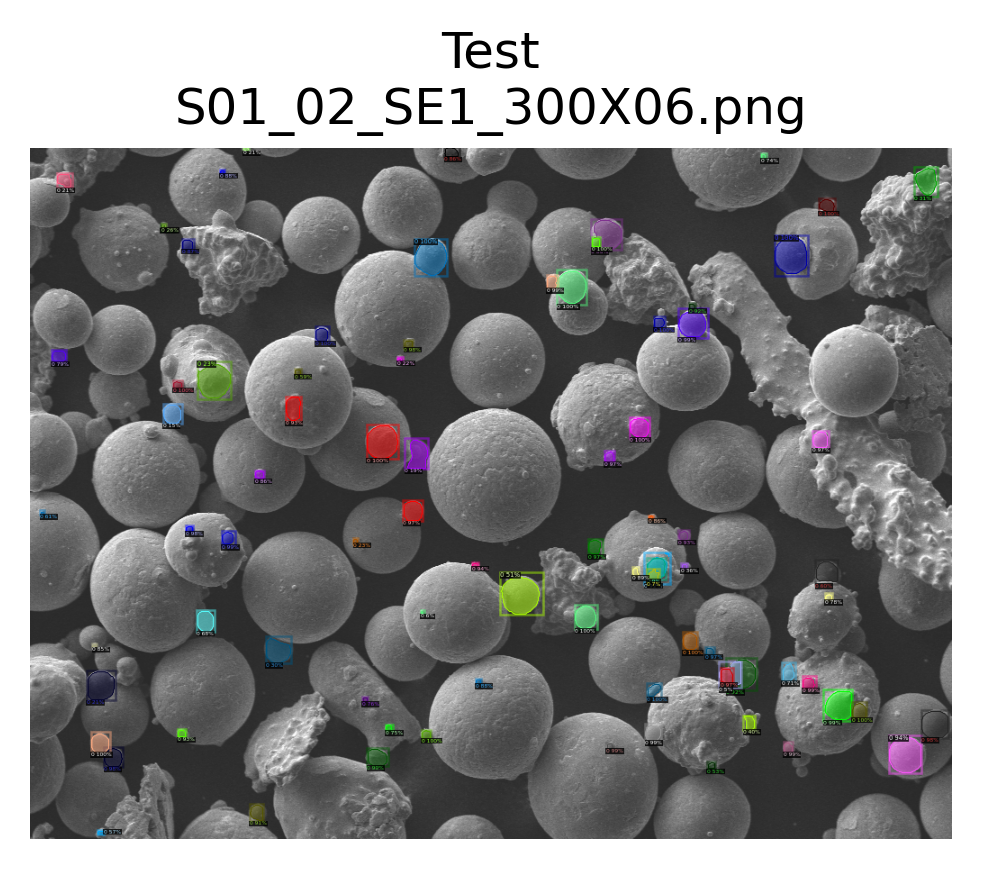

ddict info:
	path: ../Auto_annotate_images/S01_02_SE1_300X06.png
	num_instances: 84


In [10]:
img_path = Path('..', 'Auto_annotate_images','S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image


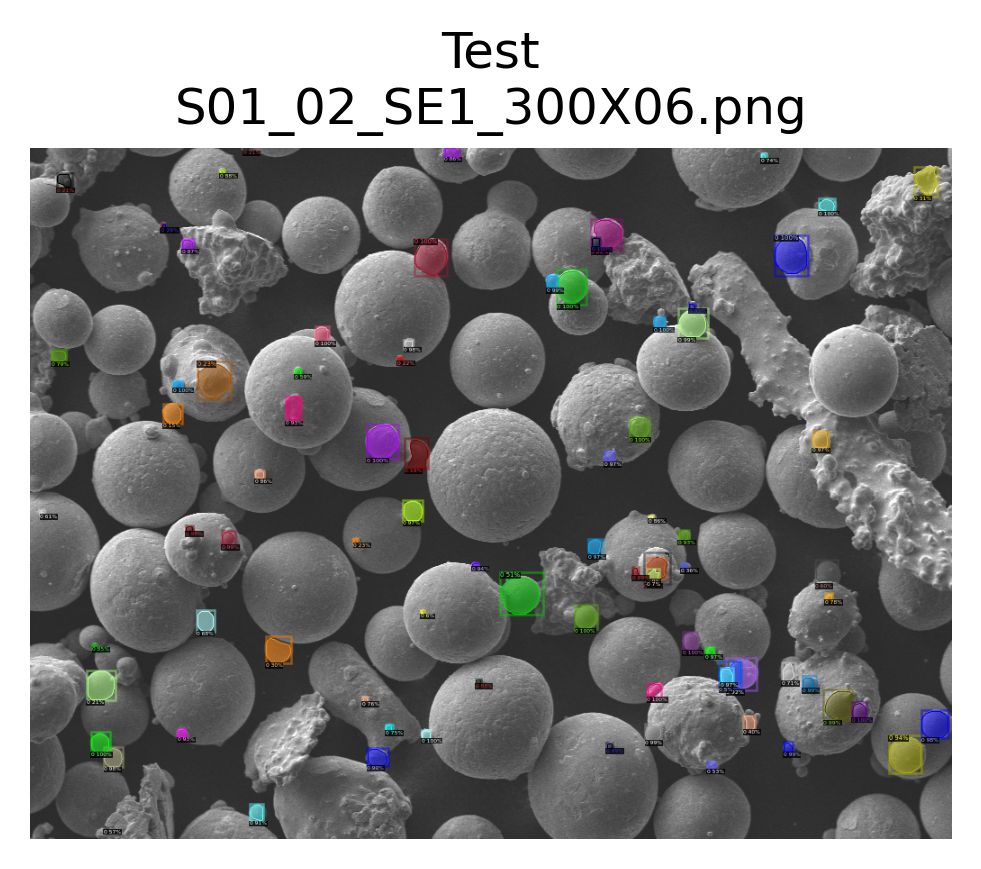

ddict info:
	path: ../Auto_annotate_images/S01_02_SE1_300X06.png
	num_instances: 84


In [11]:
img_path = Path('..', 'Auto_annotate_images','S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image


We will now generate predictions on all of the images in the training and validation sets, and save the results for later.

In [4]:
results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

NameError: name 'cfg' is not defined

Annotating: S05_02_SE1_300X59


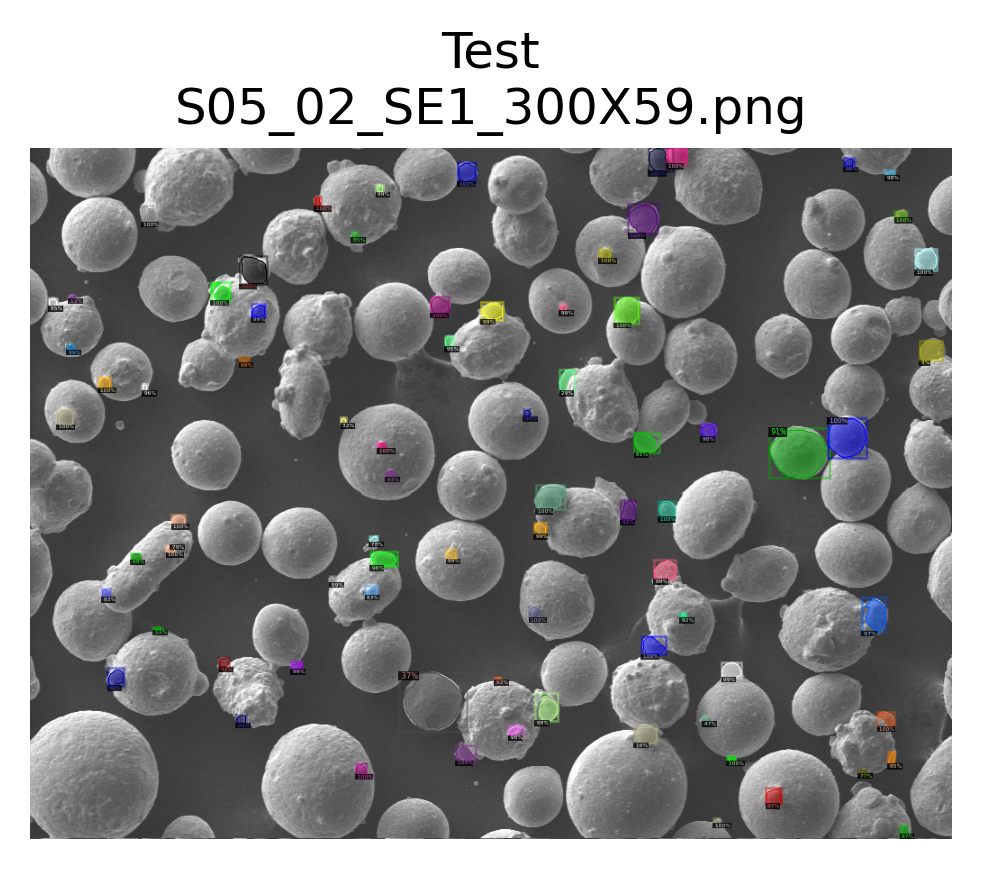

ddict info:
	path: Auto_annotate_images/S05_02_SE1_300X59.png
	num_instances: 78
Annotating: S07_01_SE1_300X81


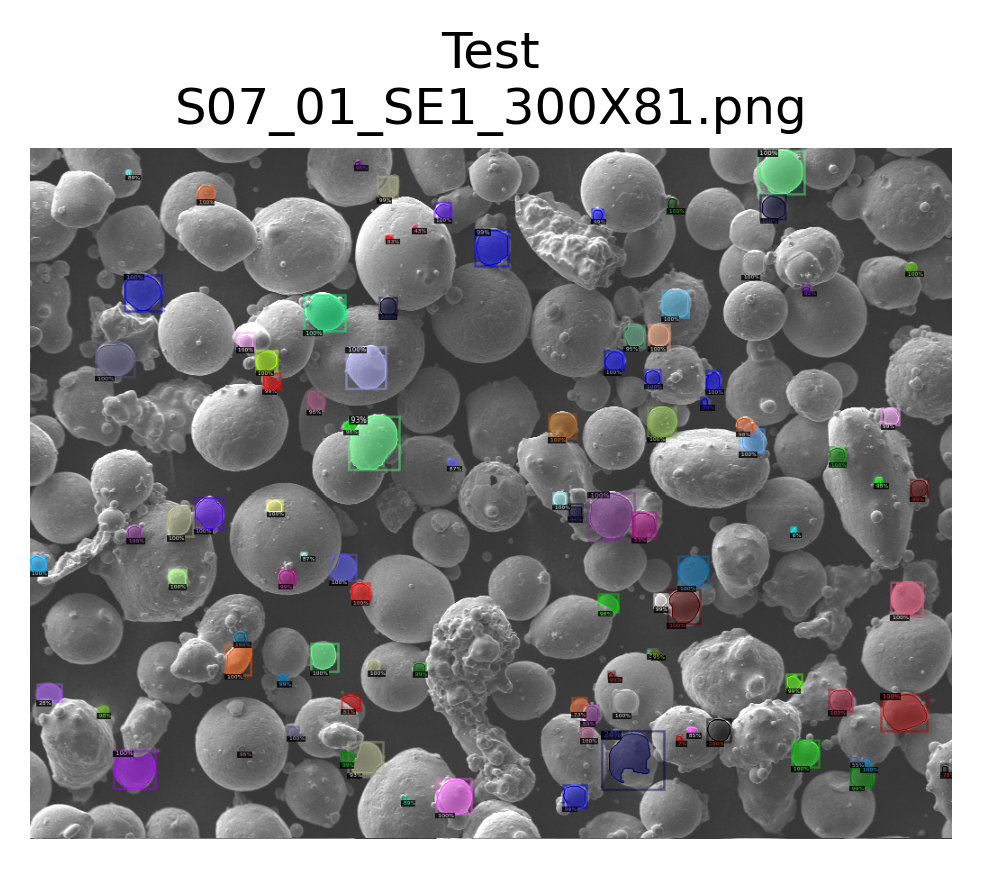

ddict info:
	path: Auto_annotate_images/S07_01_SE1_300X81.png
	num_instances: 98
Annotating: S04_03_SE1_1000X53


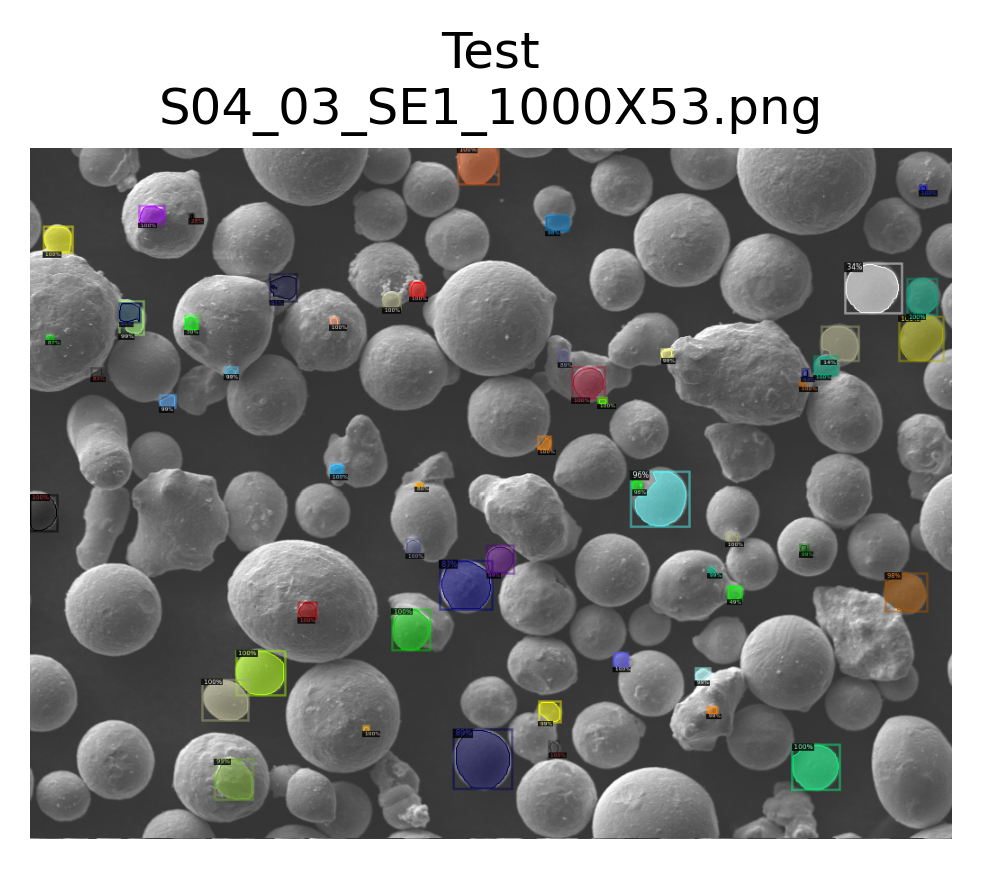

ddict info:
	path: Auto_annotate_images/S04_03_SE1_1000X53.png
	num_instances: 55
Annotating: S07_03_SE1_1000X91


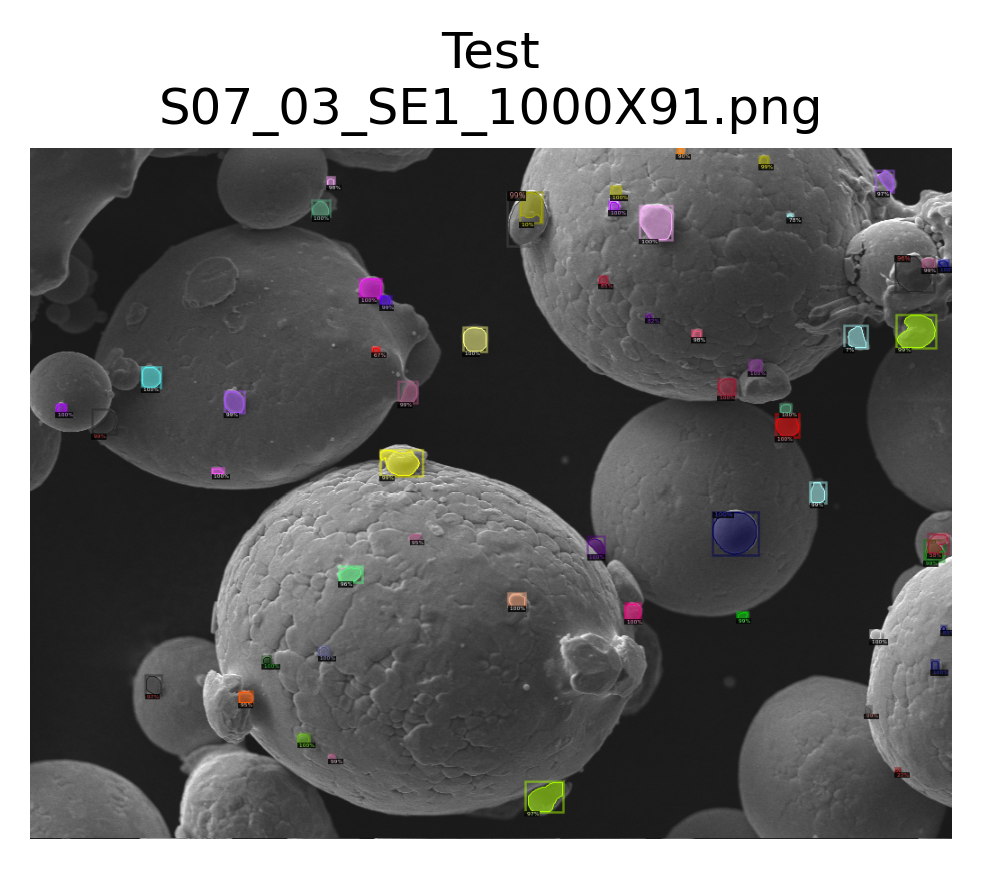

ddict info:
	path: Auto_annotate_images/S07_03_SE1_1000X91.png
	num_instances: 56
Annotating: S04_01_SE1_1000X45


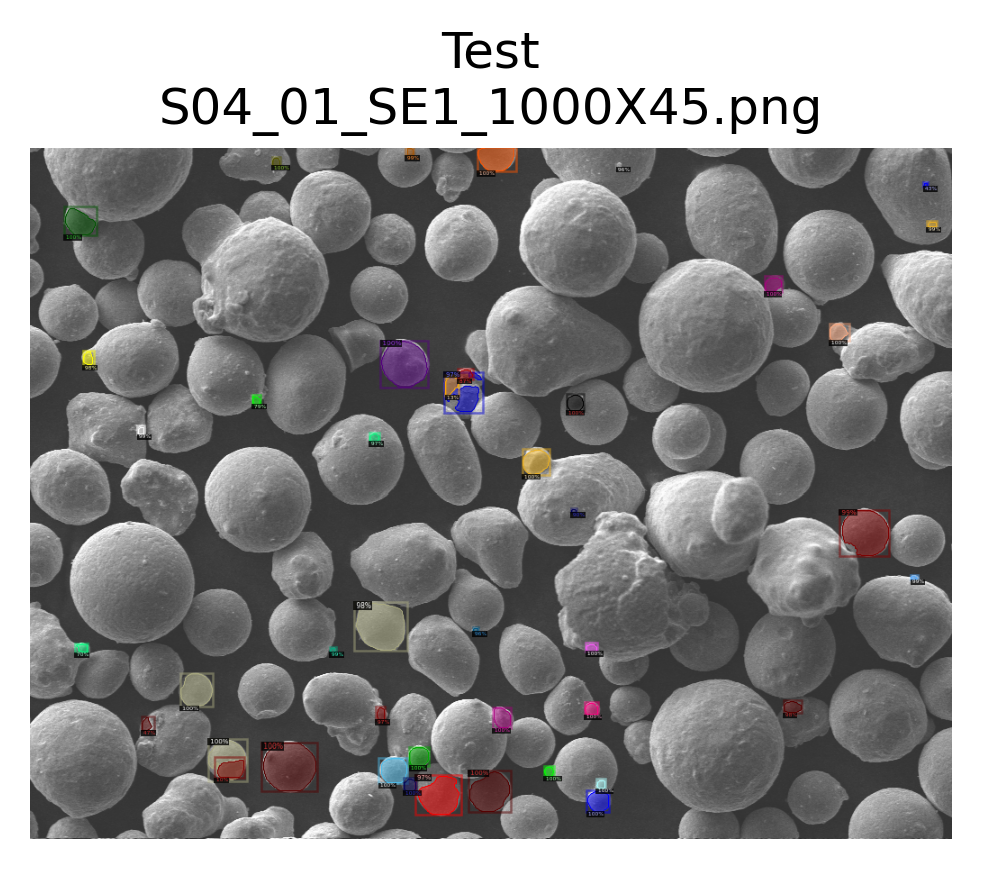

ddict info:
	path: Auto_annotate_images/S04_01_SE1_1000X45.png
	num_instances: 44
Annotating: S05_03_SE1_300X63


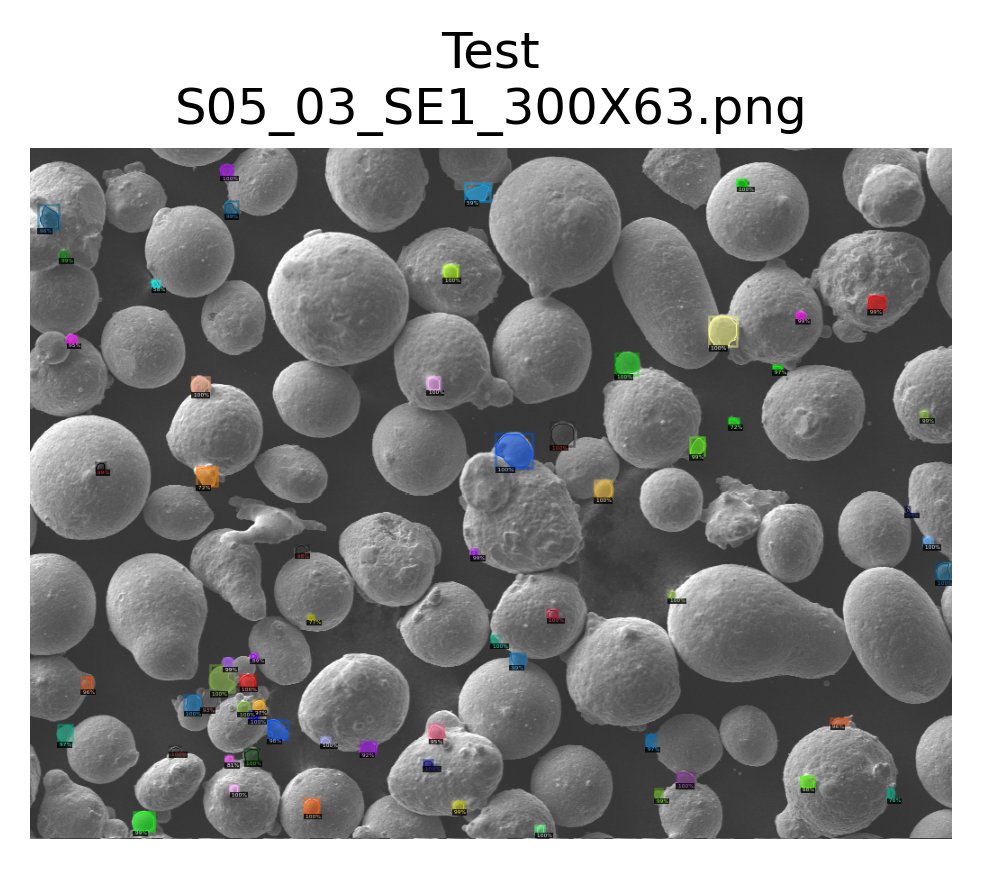

ddict info:
	path: Auto_annotate_images/S05_03_SE1_300X63.png
	num_instances: 64
Annotating: S03_03_SE1_3000X42


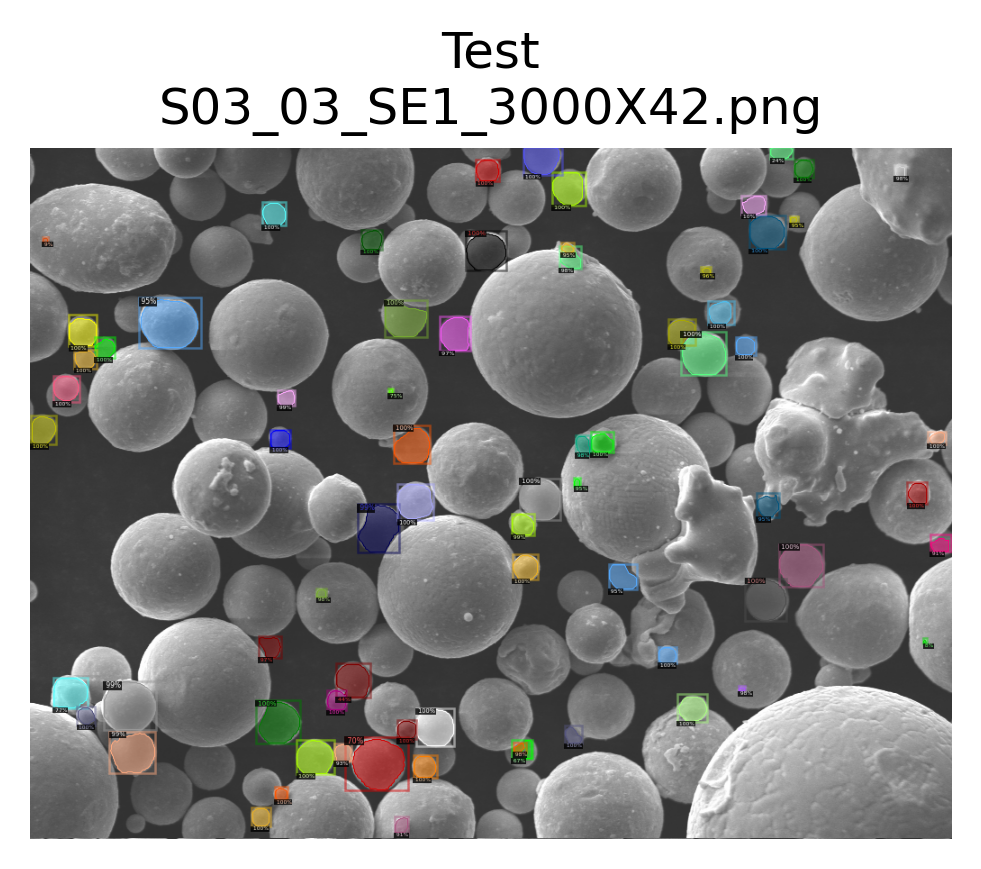

ddict info:
	path: Auto_annotate_images/S03_03_SE1_3000X42.png
	num_instances: 72
Annotating: S02_02_SE1_1000X20


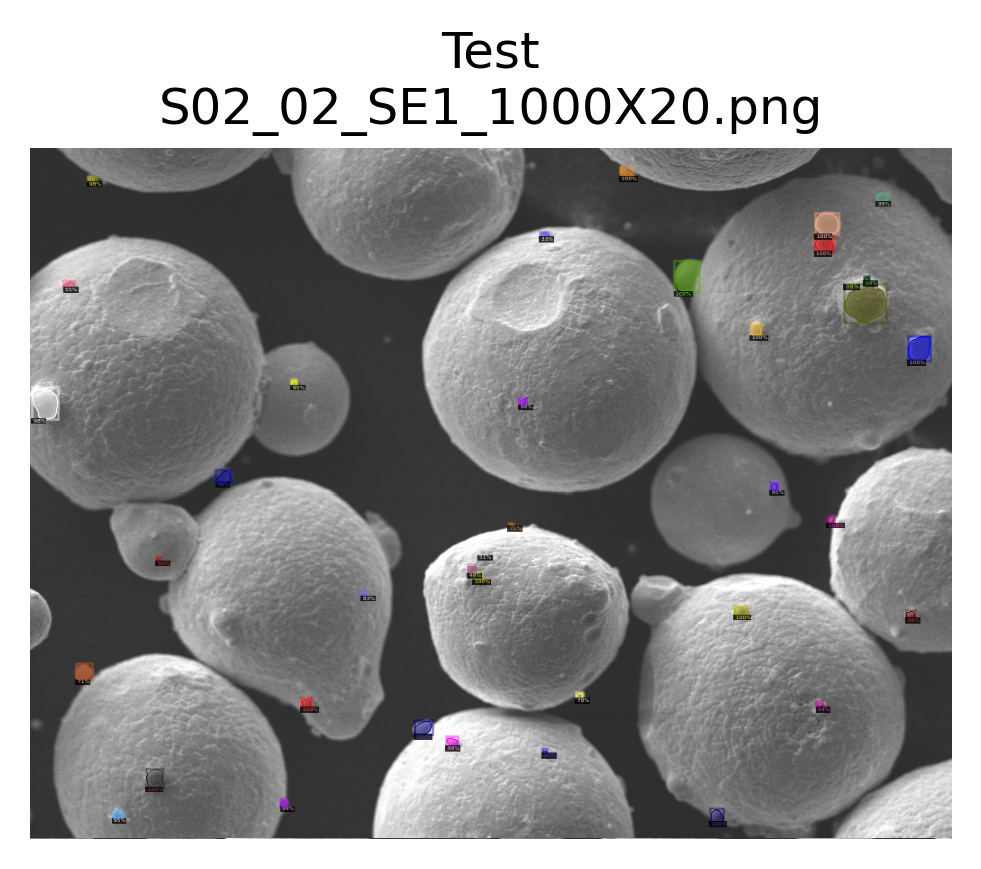

ddict info:
	path: Auto_annotate_images/S02_02_SE1_1000X20.png
	num_instances: 37
Annotating: S03_02_SE1_3000X36


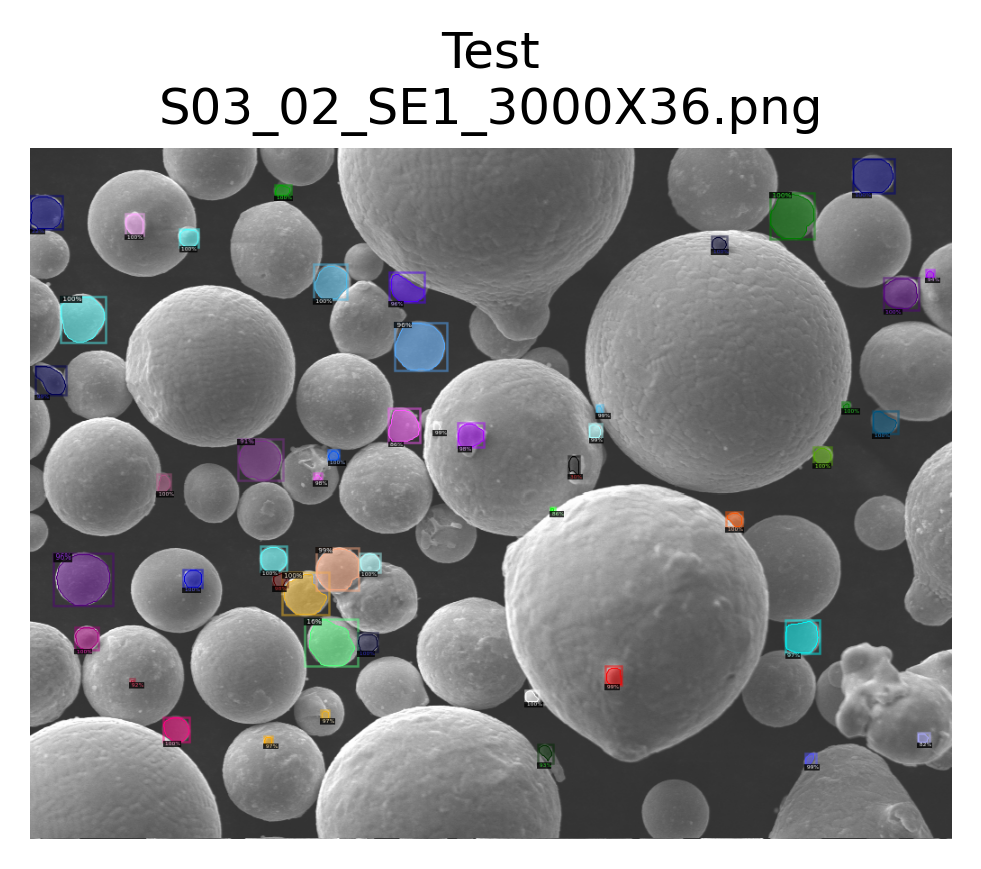

ddict info:
	path: Auto_annotate_images/S03_02_SE1_3000X36.png
	num_instances: 49
Annotating: S03_02_SE1_1250X35


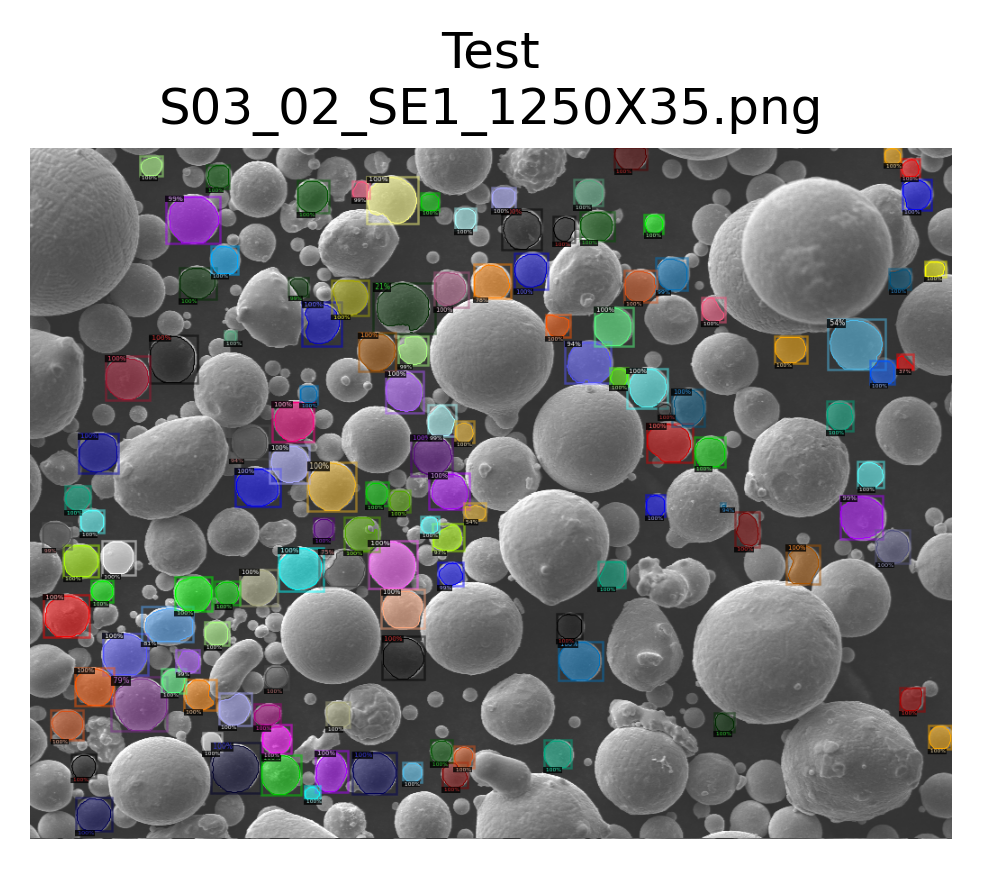

ddict info:
	path: Auto_annotate_images/S03_02_SE1_1250X35.png
	num_instances: 126
Annotating: S06_01_SE1_300X68


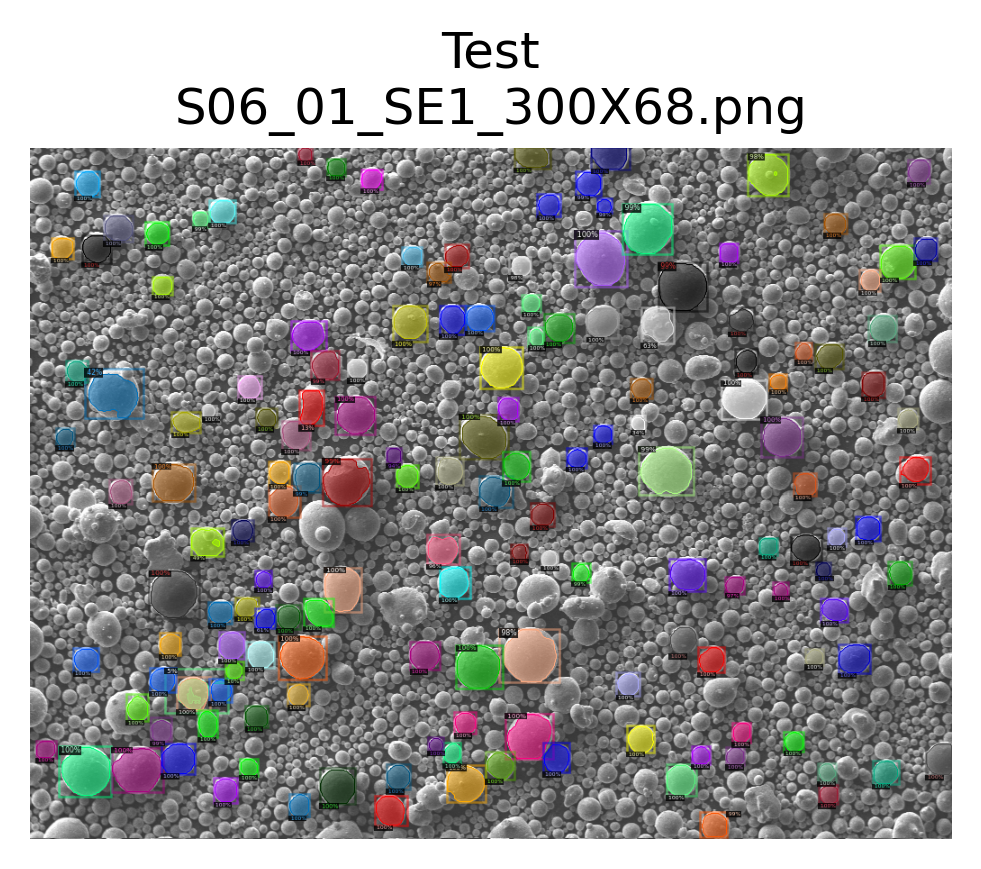

ddict info:
	path: Auto_annotate_images/S06_01_SE1_300X68.png
	num_instances: 159
Annotating: S02_03_SE1_500X23


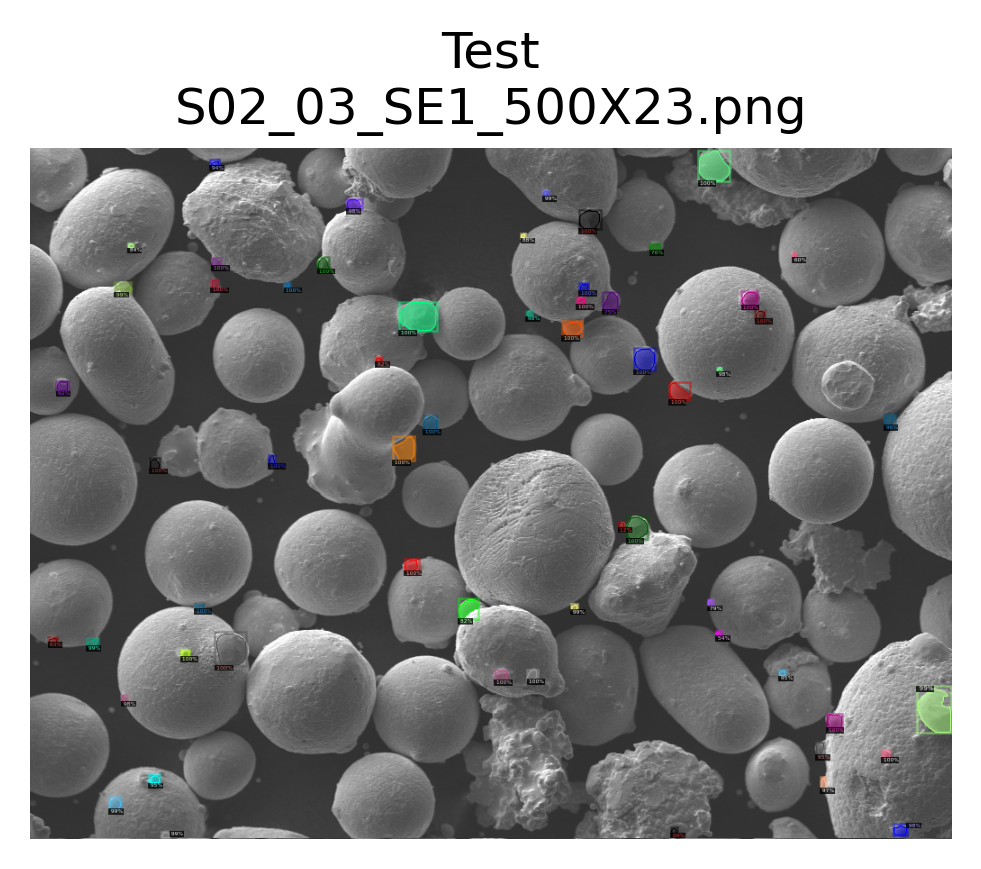

ddict info:
	path: Auto_annotate_images/S02_03_SE1_500X23.png
	num_instances: 58
Annotating: S05_01_SE1_300X56


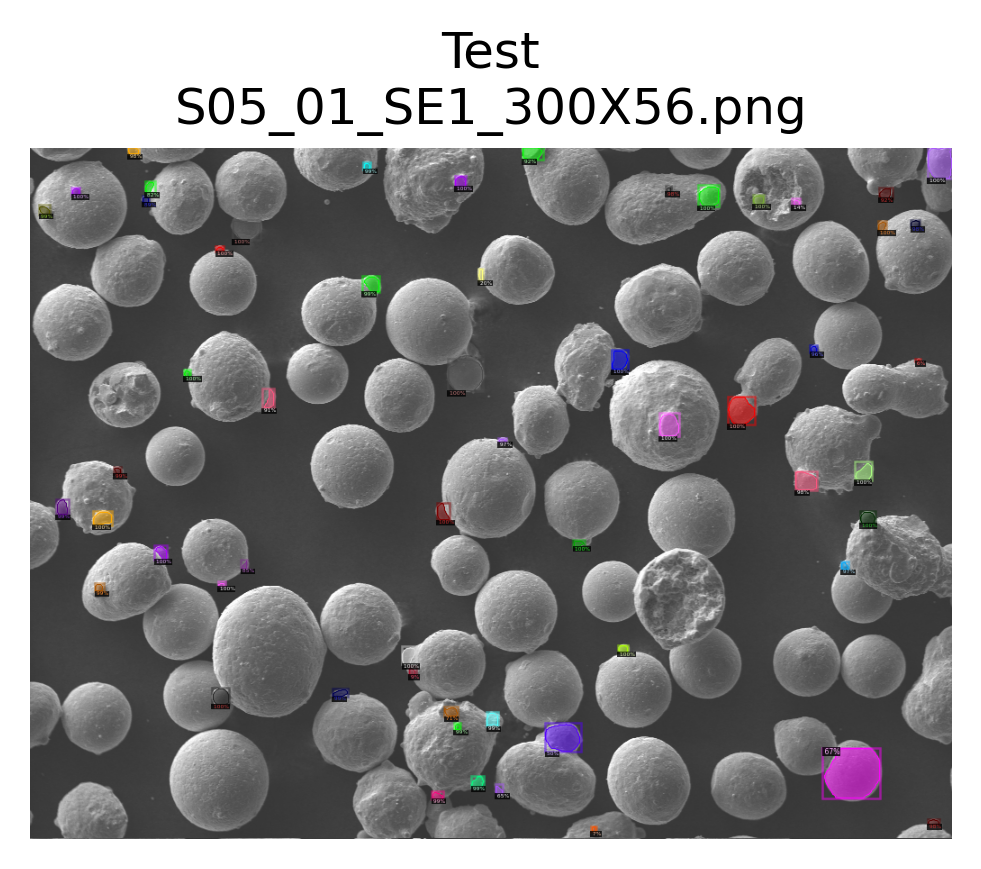

ddict info:
	path: Auto_annotate_images/S05_01_SE1_300X56.png
	num_instances: 57
Annotating: S02_01_SE1_500X15


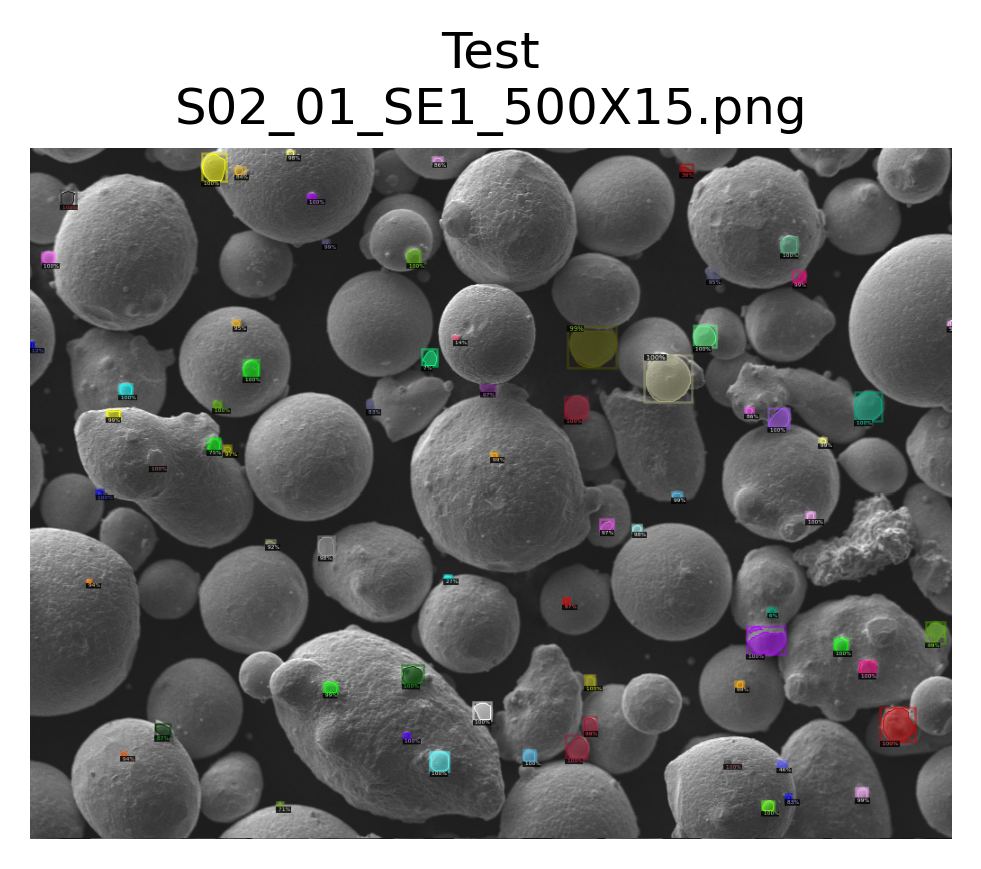

ddict info:
	path: Auto_annotate_images/S02_01_SE1_500X15.png
	num_instances: 70
Annotating: S08_01_SE1_1250X93


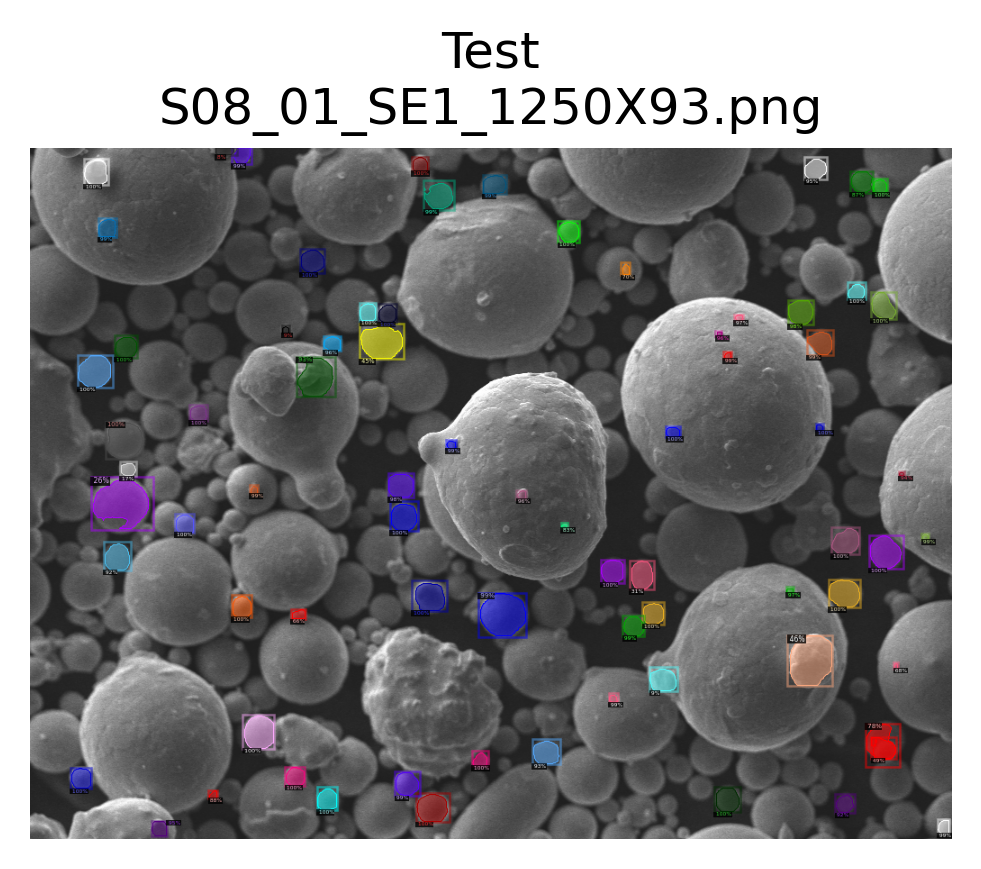

ddict info:
	path: Auto_annotate_images/S08_01_SE1_1250X93.png
	num_instances: 75
Annotating: S01_03_SE1_500X11


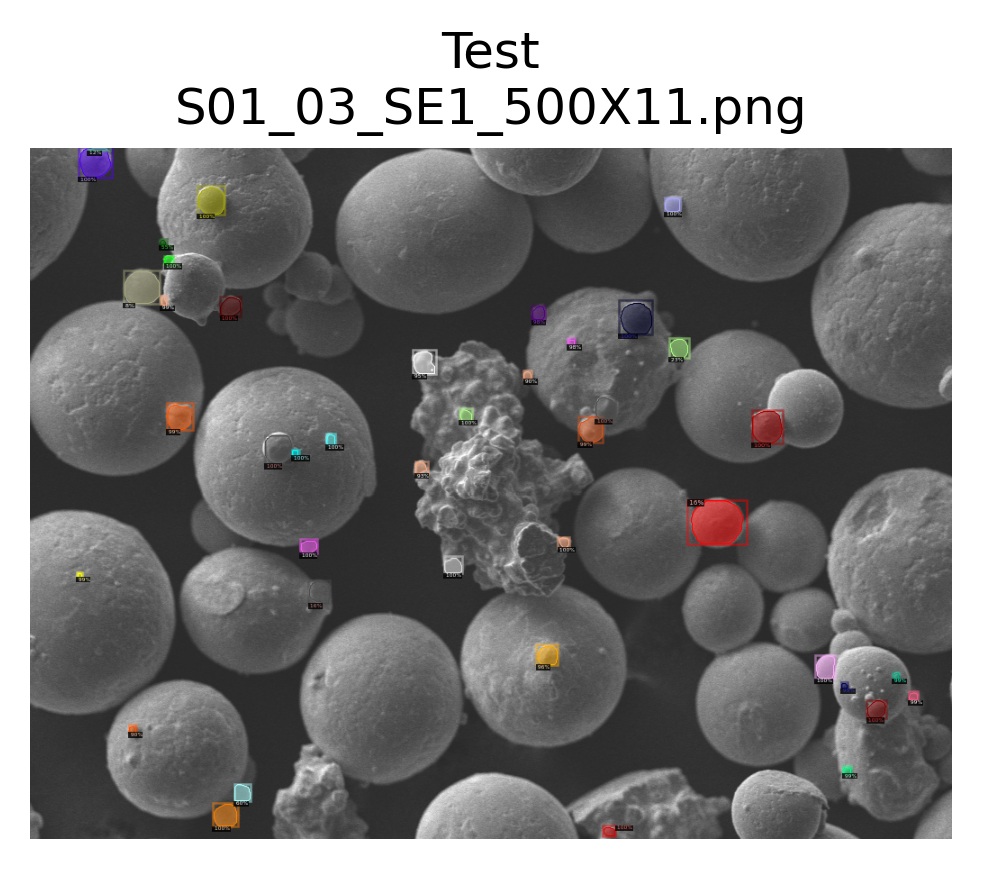

ddict info:
	path: Auto_annotate_images/S01_03_SE1_500X11.png
	num_instances: 41
Annotating: S02_02_SE1_500X19y


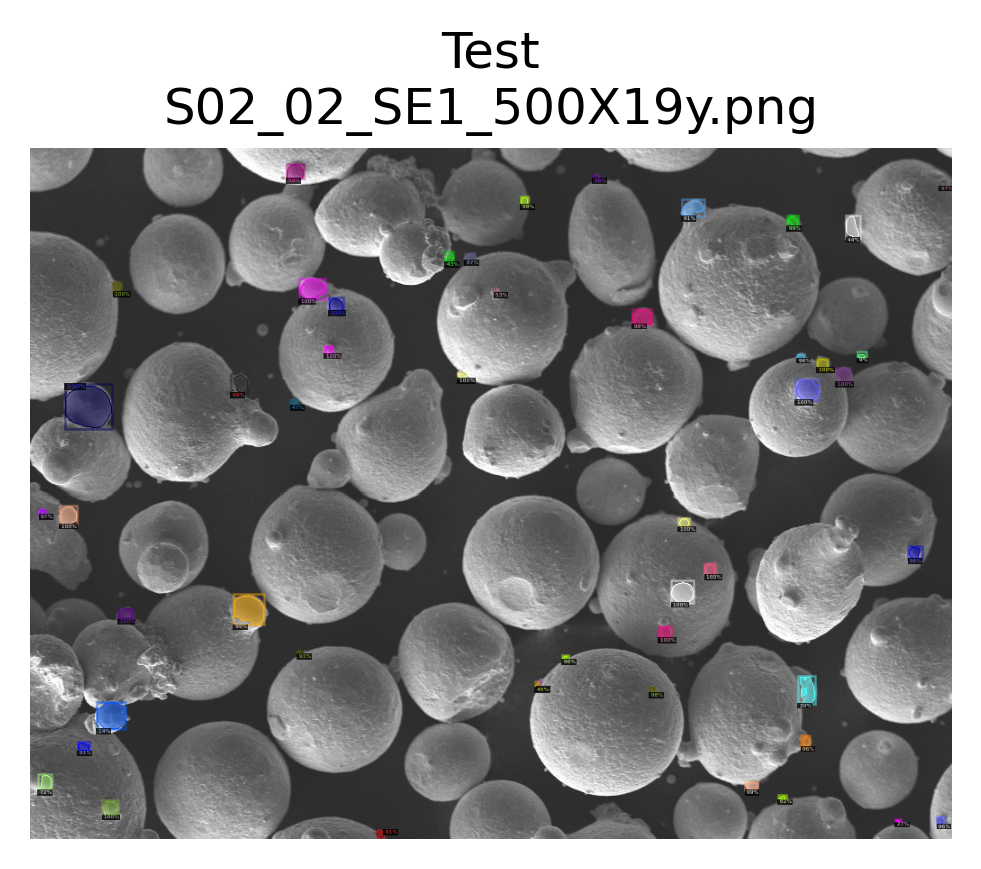

ddict info:
	path: Auto_annotate_images/S02_02_SE1_500X19y.png
	num_instances: 49
Annotating: S08_02_SE1_1000X99


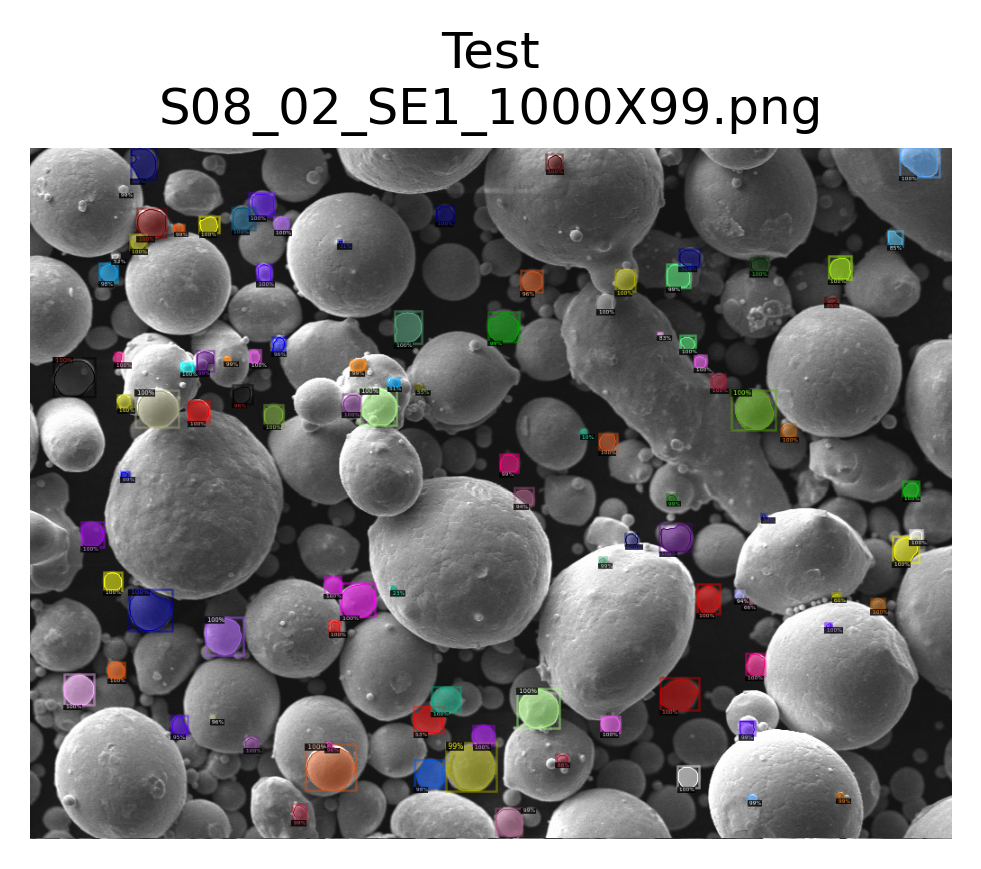

ddict info:
	path: Auto_annotate_images/S08_02_SE1_1000X99.png
	num_instances: 100
Annotating: S08_03_SE1_1000X03


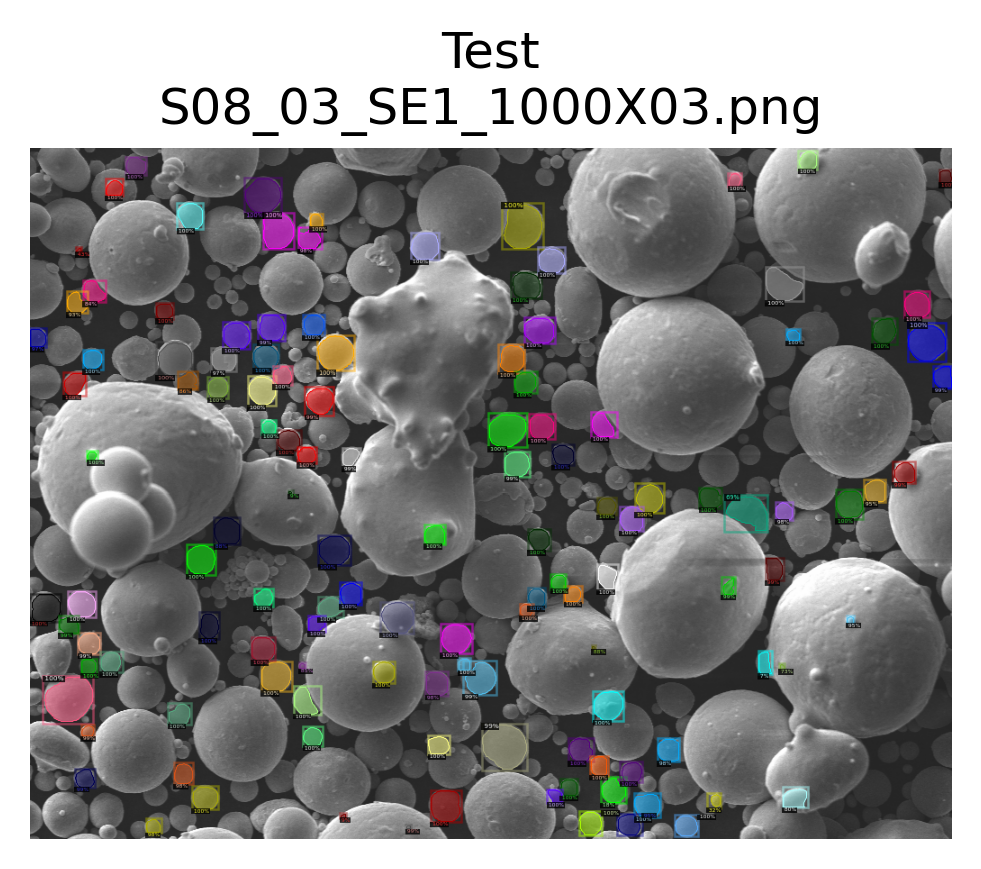

ddict info:
	path: Auto_annotate_images/S08_03_SE1_1000X03.png
	num_instances: 126
Annotating: annotations


AttributeError: 'NoneType' object has no attribute 'shape'

In [12]:
files = os.listdir('Auto_annotate_images')
img_names = []
for f in files:
    if f.split('.')[0] != '250x' and f.split('.')[0] != '500x':
        img_names.append(f.split('.')[0])
        
results = []
for f in img_names:
    print("Annotating: " + f)
    img_path = Path('Auto_annotate_images', f +'.png')
    img = cv2.imread(str(img_path))
    outs = predictor(img)
    data_utils.format_outputs(img_path, dataset='test', pred=outs)
    visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save fi$
                                 gt=False,  # specifies format as model predict$
                                 img_path=img_path, # path to image
                                 suppress_labels=True, #hides class images
                                 summary=True)  #hides the end print statement

# save to disk
with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
    pickle.dump(results, f)